In [1]:
# Cell 1: Import libraries and initialize Spark
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.types import DoubleType, StringType, IntegerType, BooleanType, FloatType
from pyspark.ml.feature import VectorAssembler, StandardScaler, StringIndexer, OneHotEncoder
from pyspark.ml.clustering import KMeans
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator, BinaryClassificationEvaluator
from pyspark.ml import Pipeline
from pyspark.ml.feature import PCA
import pandas as pd
import numpy as np
import os
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, roc_curve, auc

pio.templates.default = "plotly_white"

if not os.path.exists('_output'):
    os.makedirs('_output')

spark = SparkSession.builder \
    .appName("AI_Career_Analysis") \
    .config("spark.driver.memory", "4g") \
    .config("spark.sql.debug.maxToStringFields", 100) \
    .getOrCreate()

In [2]:
# Cell 2: Load data and select columns
df = spark.read.option("header", "true") \
              .option("inferSchema", "true") \
              .option("multiLine","true") \
              .option("escape", "\"") \
              .csv("./data/lightcast_job_postings.csv")

useful_columns = [
    'COMPANY_IS_STAFFING',
    'MIN_EDULEVELS_NAME',
    'EMPLOYMENT_TYPE_NAME',
    'MIN_YEARS_EXPERIENCE',
    'MAX_YEARS_EXPERIENCE',
    'IS_INTERNSHIP',
    'SALARY',
    'REMOTE_TYPE_NAME', 
    'STATE_NAME',
    'NAICS2_NAME',
    'LOT_V6_SPECIALIZED_OCCUPATION_NAME',
    'SKILLS_NAME',
    'LIGHTCAST_SECTORS_NAME',
]

df_selected = df.select(*useful_columns)

df_selected = df_selected.withColumn(
    "AI", 
    F.when(F.col("LIGHTCAST_SECTORS_NAME").contains("Artificial Intelligence"), True).otherwise(False)
)

In [3]:
# Cell 3: Data cleaning
df_clean = df_selected

numeric_cols = ['MIN_YEARS_EXPERIENCE', 'MAX_YEARS_EXPERIENCE', 'SALARY']
for col in numeric_cols:
    median_val = df_clean.agg(F.median(col).alias(f"median_{col}")).collect()[0][f"median_{col}"]
    df_clean = df_clean.withColumn(col, F.when(F.col(col).isNull(), median_val).otherwise(F.col(col)))

boolean_cols = []
string_cols = []

for col in useful_columns:
    if col in numeric_cols:
        continue
    
    col_type = df_clean.schema[col].dataType
    if isinstance(col_type, BooleanType):
        boolean_cols.append(col)
    else:
        string_cols.append(col)

for col in string_cols:
    df_clean = df_clean.withColumn(col, F.when(F.col(col).isNull(), "No Data").otherwise(F.col(col)))

for col in boolean_cols:
    df_clean = df_clean.withColumn(col, F.when(F.col(col).isNull(), False).otherwise(F.col(col)))

In [4]:
# Cell 4: Add skills columns
selected_skills = [
    "Python (Programming Language)", "Data Science", "Statistics", "R (Programming Language)",
    "Mathematics", "Data Analysis", "SQL (Programming Language)", "Computer Science",
    "Data Modeling", "Data Visualization", "Tableau (Business Intelligence Software)",
    "Power BI", "Automation", "Research", "Business Intelligence", "Data Management",
    "Data Warehousing", "Microsoft Excel", "SAP Applications", "Data Quality"
]

for skill in selected_skills:
    df_clean = df_clean.withColumn(
        skill.replace(" ", "_").replace("(", "").replace(")", ""),
        F.when(F.col("SKILLS_NAME").contains(skill), 1).otherwise(0)
    )

In [5]:
# Cell 5: Convert to pandas for EDA
df_pandas = df_clean.toPandas()

fig1 = px.pie(values=df_pandas['AI'].value_counts().values, 
              names=df_pandas['AI'].value_counts().index, 
              title='Distribution of AI vs Non-AI Jobs')
fig1.write_html("_output/ai_distribution.html")
fig1.show()

fig2 = px.box(df_pandas, x='AI', y='SALARY', 
              title='Salary Distribution: AI vs Non-AI Jobs')
fig2.write_html("_output/salary_distribution.html")
fig2.show()

In [6]:
# Cell 6: Industry visualization
ai_industry = df_pandas[df_pandas['AI'] == True]['NAICS2_NAME'].value_counts().nlargest(10).reset_index()
ai_industry.columns = ['Industry', 'Count']
ai_industry['Type'] = 'AI'

non_ai_industry = df_pandas[df_pandas['AI'] == False]['NAICS2_NAME'].value_counts().nlargest(10).reset_index()
non_ai_industry.columns = ['Industry', 'Count']
non_ai_industry['Type'] = 'Non-AI'

industry_df = pd.concat([ai_industry, non_ai_industry])

fig3 = px.bar(industry_df, x='Industry', y='Count', color='Type', barmode='group',
             title='Top 10 Industries: AI vs Non-AI Jobs')
fig3.write_html("_output/industry_distribution.html")
fig3.show()

In [7]:
# Cell 7: Job title visualization
ai_titles = df_pandas[df_pandas['AI'] == True]['LOT_V6_SPECIALIZED_OCCUPATION_NAME'].value_counts().nlargest(10).reset_index()
ai_titles.columns = ['Job Title', 'Count']
ai_titles['Type'] = 'AI'

non_ai_titles = df_pandas[df_pandas['AI'] == False]['LOT_V6_SPECIALIZED_OCCUPATION_NAME'].value_counts().nlargest(10).reset_index()
non_ai_titles.columns = ['Job Title', 'Count']
non_ai_titles['Type'] = 'Non-AI'

titles_df = pd.concat([ai_titles, non_ai_titles])

fig4 = px.bar(titles_df, x='Job Title', y='Count', color='Type', barmode='group',
             title='Top 10 Job Titles: AI vs Non-AI Jobs')
fig4.write_html("_output/job_title_distribution.html")
fig4.show()

In [8]:
# Cell 8: Skills visualization
skill_cols = [col for col in df_pandas.columns if any(skill.replace(" ", "_").replace("(", "").replace(")", "") == col for skill in selected_skills)]

ai_skills = df_pandas[df_pandas['AI'] == True][skill_cols].sum().reset_index()
ai_skills.columns = ['Skill', 'Count']
ai_skills['Type'] = 'AI'

non_ai_skills = df_pandas[df_pandas['AI'] == False][skill_cols].sum().reset_index()
non_ai_skills.columns = ['Skill', 'Count']
non_ai_skills['Type'] = 'Non-AI'

skills_df = pd.concat([ai_skills, non_ai_skills])

fig5 = px.bar(skills_df, x='Skill', y='Count', color='Type', barmode='group',
             title='Skills Distribution: AI vs Non-AI Jobs')
fig5.write_html("_output/skills_distribution.html")
fig5.show()

In [9]:
# Cell 9: KMeans clustering setup
feature_cols = [
    'SALARY',
    'Python_Programming_Language',
    'Data_Science',
    'Statistics',
    'R_Programming_Language',
    'Mathematics',
    'Data_Analysis',
    'SQL_Programming_Language',
    'Computer_Science',
    'Data_Modeling',
    'Data_Visualization',
    'Tableau_Business_Intelligence_Software',
    'Power_BI',
    'Automation',
    'Research',
    'Business_Intelligence',
    'Data_Management',
    'Data_Warehousing',
    'Microsoft_Excel',
    'SAP_Applications',
    'Data_Quality'
]

assembler = VectorAssembler(inputCols=feature_cols, outputCol="features_unscaled")
scaler = StandardScaler(inputCol="features_unscaled", outputCol="features", withStd=True, withMean=True)

pipeline = Pipeline(stages=[assembler, scaler])

model = pipeline.fit(df_clean)
df_transformed = model.transform(df_clean)

kmeans = KMeans(k=2, seed=42, featuresCol="features")
kmeans_model = kmeans.fit(df_transformed)

df_with_clusters = kmeans_model.transform(df_transformed)

In [10]:
# Cell 10: PCA transformation for visualization
pca = PCA(k=2, inputCol="features", outputCol="pca_features")
pca_model = pca.fit(df_transformed)
df_pca = pca_model.transform(df_transformed)

df_pca_pandas = df_pca.select("pca_features", "AI").toPandas()
df_clusters_pandas = df_with_clusters.select("prediction").toPandas()

df_pca_pandas['PCA1'] = df_pca_pandas['pca_features'].apply(lambda x: float(x[0]))
df_pca_pandas['PCA2'] = df_pca_pandas['pca_features'].apply(lambda x: float(x[1]))
df_pca_pandas['Cluster'] = df_clusters_pandas['prediction']

In [11]:
# Cell 11: Cluster visualization
fig6 = px.scatter(
    df_pca_pandas, 
    x='PCA1', 
    y='PCA2', 
    color='Cluster',
    title='KMeans Clustering: PCA Visualization of Job Clusters',
    labels={'PCA1': 'Principal Component 1', 'PCA2': 'Principal Component 2'},
    color_discrete_sequence=['#1f77b4', '#ff7f0e']
)
fig6.write_html("_output/kmeans_clusters.html")
fig6.show()

fig7 = px.scatter(
    df_pca_pandas, 
    x='PCA1', 
    y='PCA2', 
    color='AI',
    title='AI vs Non-AI Jobs: PCA Visualization',
    labels={'PCA1': 'Principal Component 1', 'PCA2': 'Principal Component 2'},
    color_discrete_sequence=['#2ca02c', '#d62728'],
    category_orders={"AI": [True, False]}
)
fig7.write_html("_output/ai_vs_non_ai_pca.html")
fig7.show()

In [12]:
# Cell 12: Cluster analysis
cluster_ai_count = df_pca_pandas.groupby(['Cluster', 'AI']).size().unstack(fill_value=0)

cluster_ai_table = pd.DataFrame({
    'Cluster': ['Cluster 0', 'Cluster 1'],
    'AI Jobs': cluster_ai_count[True].values,
    'Non-AI Jobs': cluster_ai_count[False].values
})

cluster_ai_table['Total'] = cluster_ai_table['AI Jobs'] + cluster_ai_table['Non-AI Jobs']
cluster_ai_table['AI %'] = cluster_ai_table['AI Jobs'] / cluster_ai_table['Total'] * 100
cluster_ai_table['Non-AI %'] = cluster_ai_table['Non-AI Jobs'] / cluster_ai_table['Total'] * 100

fig8 = px.bar(
    cluster_ai_table,
    x='Cluster',
    y=['AI Jobs', 'Non-AI Jobs'],
    title='Distribution of AI and Non-AI Jobs in Each Cluster',
    barmode='group'
)
fig8.write_html("_output/cluster_ai_distribution.html")
fig8.show()

In [13]:
# Cell 13: Classification preparation
df_clean = df_clean.withColumn("AI_label", F.when(F.col("AI") == True, 1.0).otherwise(0.0))

feature_cols = [
    'MIN_YEARS_EXPERIENCE',
    'MAX_YEARS_EXPERIENCE',
    'SALARY',
    'Python_Programming_Language',
    'Data_Science',
    'Statistics', 
    'R_Programming_Language',
    'Mathematics',
    'Data_Analysis',
    'SQL_Programming_Language',
    'Computer_Science',
    'Data_Modeling',
    'Data_Visualization',
    'Tableau_Business_Intelligence_Software',
    'Power_BI',
    'Automation',
    'Research',
    'Business_Intelligence',
    'Data_Management',
    'Data_Warehousing',
    'Microsoft_Excel',
    'SAP_Applications',
    'Data_Quality'
]

categorical_cols = [
    'EMPLOYMENT_TYPE_NAME', 
    'REMOTE_TYPE_NAME',
    'MIN_EDULEVELS_NAME',
    'STATE_NAME',
    'NAICS2_NAME',
    'LOT_V6_SPECIALIZED_OCCUPATION_NAME',
]

train_df, test_df = df_clean.randomSplit([0.8, 0.2], seed=42)

In [14]:
# Cell 14: Logistic Regression model
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_indexed") for col in categorical_cols]
encoders = [OneHotEncoder(inputCol=f"{col}_indexed", outputCol=f"{col}_encoded") for col in categorical_cols]
encoded_cols = [f"{col}_encoded" for col in categorical_cols]

assembler = VectorAssembler(inputCols=feature_cols + encoded_cols, outputCol="features")
lr = LogisticRegression(featuresCol="features", labelCol="AI_label", maxIter=10, regParam=0.01)
lr_pipeline = Pipeline(stages=indexers + encoders + [assembler, lr])

lr_model = lr_pipeline.fit(train_df)
lr_predictions = lr_model.transform(test_df)

evaluator = BinaryClassificationEvaluator(labelCol="AI_label", rawPredictionCol="rawPrediction")
accuracy_evaluator = MulticlassClassificationEvaluator(labelCol="AI_label", predictionCol="prediction", metricName="accuracy")

lr_accuracy = accuracy_evaluator.evaluate(lr_predictions)
lr_auroc = evaluator.evaluate(lr_predictions)

print(f"Logistic Regression - Accuracy: {lr_accuracy:.3f}, AUC: {lr_auroc:.3f}")

Logistic Regression - Accuracy: 0.886, AUC: 0.819


In [15]:
# Cell 15: Random Forest model
rf = RandomForestClassifier(featuresCol="features", labelCol="AI_label", numTrees=100, maxDepth=10, seed=42)
rf_pipeline = Pipeline(stages=indexers + encoders + [assembler, rf])

rf_model = rf_pipeline.fit(train_df)
rf_predictions = rf_model.transform(test_df)

rf_accuracy = accuracy_evaluator.evaluate(rf_predictions)
rf_auroc = evaluator.evaluate(rf_predictions)

print(f"Random Forest - Accuracy: {rf_accuracy:.3f}, AUC: {rf_auroc:.3f}")

Random Forest - Accuracy: 0.900, AUC: 0.867


In [16]:
# Cell 16: Logistic Regression evaluation
lr_pred_pandas = lr_predictions.select("AI_label", "prediction", "probability").toPandas()

lr_cm = confusion_matrix(lr_pred_pandas["AI_label"], lr_pred_pandas["prediction"])

lr_precision, lr_recall, lr_f1, _ = precision_recall_fscore_support(
    lr_pred_pandas["AI_label"], 
    lr_pred_pandas["prediction"], 
    average='binary'
)

lr_fpr, lr_tpr, _ = roc_curve(
    lr_pred_pandas["AI_label"], 
    lr_pred_pandas["probability"].apply(lambda x: float(x[1]))
)
lr_auc = auc(lr_fpr, lr_tpr)

print(f"Logistic Regression Metrics:")
print(f"Precision: {lr_precision:.3f}")
print(f"Recall: {lr_recall:.3f}")
print(f"F1 Score: {lr_f1:.3f}")
print(f"AUC: {lr_auc:.3f}")

fig9 = px.imshow(
    lr_cm,
    text_auto=True,
    labels=dict(x="Predicted", y="Actual"),
    x=['Non-AI', 'AI'],
    y=['Non-AI', 'AI'],
    title='Logistic Regression Confusion Matrix',
    color_continuous_scale='Blues'
)
fig9.write_html("_output/lr_confusion_matrix.html")
fig9.show()

Logistic Regression Metrics:
Precision: 0.589
Recall: 0.211
F1 Score: 0.311
AUC: 0.819


Random Forest Metrics:
Precision: 0.958
Recall: 0.190
F1 Score: 0.318
AUC: 0.867


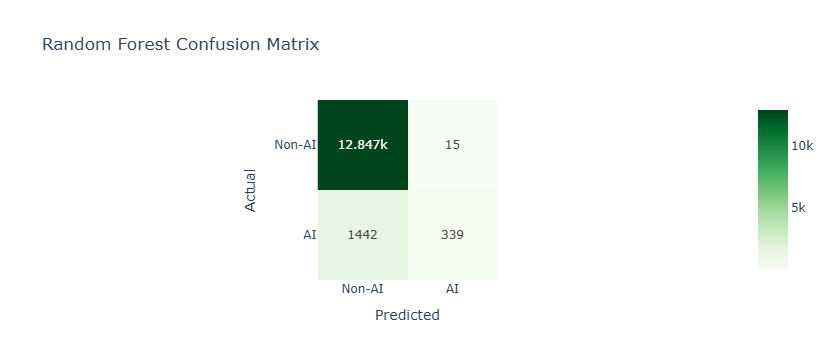

In [17]:
# Cell 17: Random Forest evaluation
rf_pred_pandas = rf_predictions.select("AI_label", "prediction", "probability").toPandas()

rf_cm = confusion_matrix(rf_pred_pandas["AI_label"], rf_pred_pandas["prediction"])

rf_precision, rf_recall, rf_f1, _ = precision_recall_fscore_support(
    rf_pred_pandas["AI_label"], 
    rf_pred_pandas["prediction"], 
    average='binary'
)

rf_fpr, rf_tpr, _ = roc_curve(
    rf_pred_pandas["AI_label"], 
    rf_pred_pandas["probability"].apply(lambda x: float(x[1]))
)
rf_auc = auc(rf_fpr, rf_tpr)

print(f"Random Forest Metrics:")
print(f"Precision: {rf_precision:.3f}")
print(f"Recall: {rf_recall:.3f}")
print(f"F1 Score: {rf_f1:.3f}")
print(f"AUC: {rf_auc:.3f}")

fig10 = px.imshow(
    rf_cm,
    text_auto=True,
    labels=dict(x="Predicted", y="Actual"),
    x=['Non-AI', 'AI'],
    y=['Non-AI', 'AI'],
    title='Random Forest Confusion Matrix',
    color_continuous_scale='Greens'
)
fig10.write_html("_output/rf_confusion_matrix.html")
fig10.show()

In [18]:
# Cell 18: ROC Curve comparison
fig11 = go.Figure()

fig11.add_trace(go.Scatter(
    x=lr_fpr,
    y=lr_tpr,
    name=f'Logistic Regression (AUC = {lr_auc:.3f})',
    mode='lines'
))

fig11.add_trace(go.Scatter(
    x=rf_fpr,
    y=rf_tpr,
    name=f'Random Forest (AUC = {rf_auc:.3f})',
    mode='lines'
))

fig11.add_trace(go.Scatter(
    x=[0, 1],
    y=[0, 1],
    mode='lines',
    name='Random',
    line=dict(dash='dash')
))

fig11.update_layout(
    title='ROC Curves for AI Job Classification',
    xaxis=dict(title='False Positive Rate'),
    yaxis=dict(title='True Positive Rate'),
    legend=dict(x=0.1, y=0.9)
)

fig11.write_html("_output/roc_curves.html")
fig11.show()

In [19]:
# Cell 19: Model comparison table
metrics_df = pd.DataFrame({
    'Model': ['Logistic Regression', 'Random Forest'],
    'Accuracy': [lr_accuracy, rf_accuracy],
    'Precision': [lr_precision, rf_precision],
    'Recall': [lr_recall, rf_recall],
    'F1 Score': [lr_f1, rf_f1],
    'AUC': [lr_auc, rf_auc]
})

fig12 = go.Figure(data=[go.Table(
    header=dict(
        values=list(metrics_df.columns),
        fill_color='paleturquoise',
        align='left'
    ),
    cells=dict(
        values=[metrics_df[col] for col in metrics_df.columns],
        fill_color='lavender',
        align='left',
        format=[None, '.3f', '.3f', '.3f', '.3f', '.3f']
    )
)])

fig12.update_layout(title='Classification Metrics Comparison')
fig12.write_html("_output/metrics_comparison.html")
fig12.show()
